In [ ]:
# upload files from google drive url

!pip install gdown

You should consider upgrading via the 'C:\Users\perso\Desktop\Stage\ContainerVision-Marsa_Maroc\env\Scripts\python.exe -m pip install --upgrade pip' command.



  Using cached tqdm-4.67.1-py3-none-any.whl (78 kB)
  Using cached filelock-3.18.0-py3-none-any.whl (16 kB)
  Using cached idna-3.10-py3-none-any.whl (70 kB)
  Using cached charset_normalizer-3.4.2-cp310-cp310-win_amd64.whl (105 kB)
  Using cached PySocks-1.7.1-py3-none-any.whl (16 kB)


In [ ]:
# : upload with gdown this zip folders with url of google drive https://drive.google.com/drive/folders/13LpHEeFExmDJnw_U9peqLR-8uAAUMEzi

# Note: The provided URL is for a Google Drive *folder*, not a single file.
# gdown can download folders, but it needs the folder ID, not the shared link.
# The folder ID is part of the URL.
folder_id = '13LpHEeFExmDJnw_U9peqLR-8uAAUMEzi'

# Use gdown to download the folder.
# The --folder flag is crucial here.
!gdown --folder https://drive.google.com/drive/folders/{folder_id}

Processing file 1Epxm-s7q9hAuhX_eTd47Wi68-6rvlNmi test_images.zip
Processing file 1UejImWAdEZsVz6C2wtgTrKjKxPlfKnxc train_images_label.zip
Processing file 1F7VmkXmJcADnPwZkzavGlFcqygHLOMSX train_images.zip


Retrieving folder contents
Retrieving folder contents completed
Building directory structure
Building directory structure completed
Downloading...
From (original): https://drive.google.com/uc?id=1Epxm-s7q9hAuhX_eTd47Wi68-6rvlNmi
From (redirected): https://drive.google.com/uc?id=1Epxm-s7q9hAuhX_eTd47Wi68-6rvlNmi&confirm=t&uuid=3e6b9d66-2235-4451-a8fa-dc5ef45ea4c4
To: c:\Users\perso\Desktop\Stage\ContainerVision-Marsa_Maroc\notebook\ContainerNum_dataset\test_images.zip

  0%|          | 0.00/206M [00:00<?, ?B/s]
  1%|          | 1.57M/206M [00:00<00:15, 13.4MB/s]
  4%|▍         | 8.39M/206M [00:00<00:04, 42.7MB/s]
  6%|▋         | 13.1M/206M [00:00<00:04, 42.2MB/s]
 10%|█         | 21.0M/206M [00:00<00:03, 55.0MB/s]
 13%|█▎        | 26.7M/206M [00:00<00:04, 38.3MB/s]
 18%|█▊        | 36.7M/206M [00:00<00:03, 51.6MB/s]
 23%|██▎       | 47.2M/206M [00:00<00:02, 63.9MB/s]
 28%|██▊       | 58.2M/206M [00:00<00:01, 75.8MB/s]
 34%|███▍      | 69.7M/206M [00:01<00:01, 86.4MB/s]
 39%|███▉      |

In [ ]:
import zipfile
import os

zip_path = "ContainerNum_dataset/train_images.zip"

if os.path.exists(zip_path):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall()
    print(f"Extracted to current directory")
else:
    print(f"Zip file not found at {zip_path}")

Extracted to current directory


In [11]:
import zipfile
import os

zip_path = "ContainerNum_dataset/train_images_label.zip"

if os.path.exists(zip_path):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall()
    print(f"Extracted to current directory")
else:
    print(f"Zip file not found at {zip_path}")

Extracted to current directory


In [14]:
angles = set({})
for filename in os.listdir("images"):
  if len(filename.split("-")) < 4:
    continue
  angles.add(filename.split("-")[3])

print(angles)

{'AH', 'AS', 'LF', 'LB', 'RF'}


LF: Left Front

RF: Right Front

LB: Left Back

AH: Above Horizontal (Top view)

AS: Above Side (Side-top view or angular top)

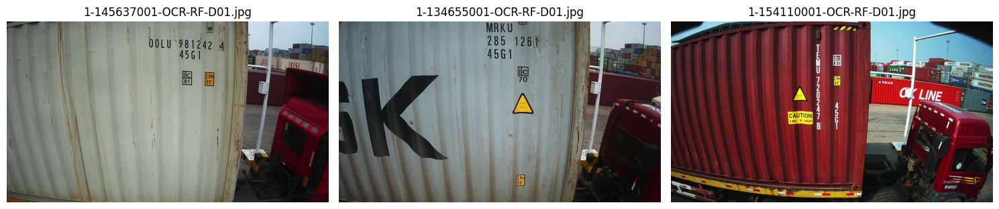

In [1]:
# : give a function that display three random image that have a specific word in the name of the image

import os
import random
from PIL import Image
import matplotlib.pyplot as plt

def display_random_images_with_word(directory, search_word, num_images=3):
  """
  Displays a specified number of random images from a directory that contain a specific word in their filename.

  Args:
    directory (str): The path to the directory containing the images.
    search_word (str): The word to search for in the image filenames.
    num_images (int): The number of random images to display (default is 3).
  """
  image_files = []
  for filename in os.listdir(directory):
    if search_word in filename.lower() and (filename.endswith('.jpg') or filename.endswith('.jpeg') or filename.endswith('.png')):
      image_files.append(os.path.join(directory, filename))

  if not image_files:
    print(f"No images found containing the word '{search_word}' in directory '{directory}'.")
    return

  # Select random images
  num_to_display = min(num_images, len(image_files))
  selected_images = random.sample(image_files, num_to_display)

  # Display the images
  plt.figure(figsize=(15, 5))
  for i, img_path in enumerate(selected_images):
    try:
      img = Image.open(img_path)
      plt.subplot(1, num_to_display, i + 1)
      plt.imshow(img)
      plt.title(os.path.basename(img_path))
      plt.axis('off')
    except Exception as e:
      print(f"Could not open or display image {img_path}: {e}")

  plt.tight_layout()
  plt.show()

# Example usage (assuming your images are in a directory named 'train_images' after unzipping)
display_random_images_with_word('images', 'rf', num_images=3)

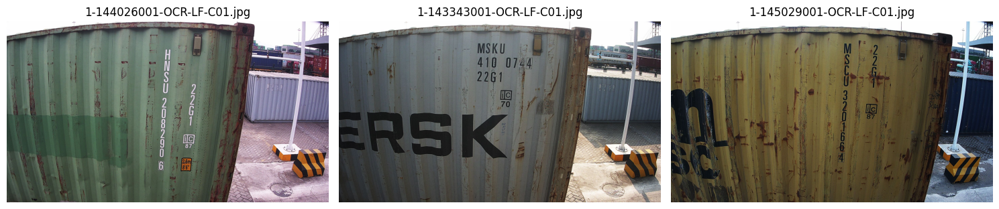

In [15]:
display_random_images_with_word('images', 'lf', num_images=3)

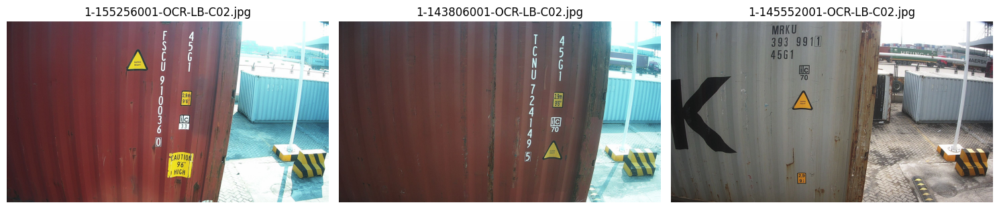

In [16]:
display_random_images_with_word('images', 'lb', num_images=3)

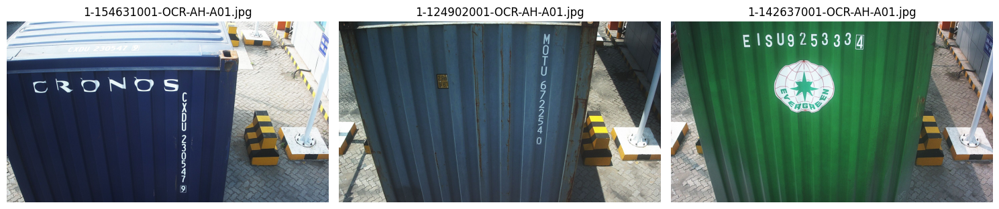

In [17]:
display_random_images_with_word('images', 'ah', num_images=3)

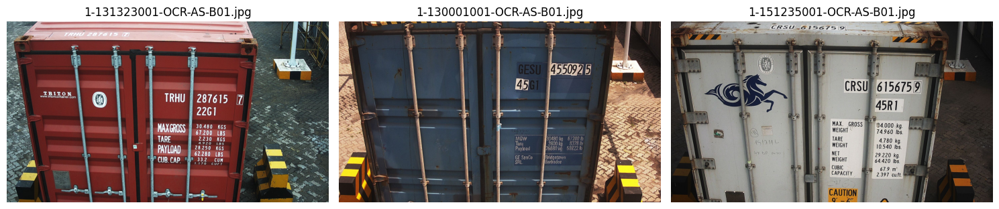

In [18]:
display_random_images_with_word('images', 'as', num_images=3)

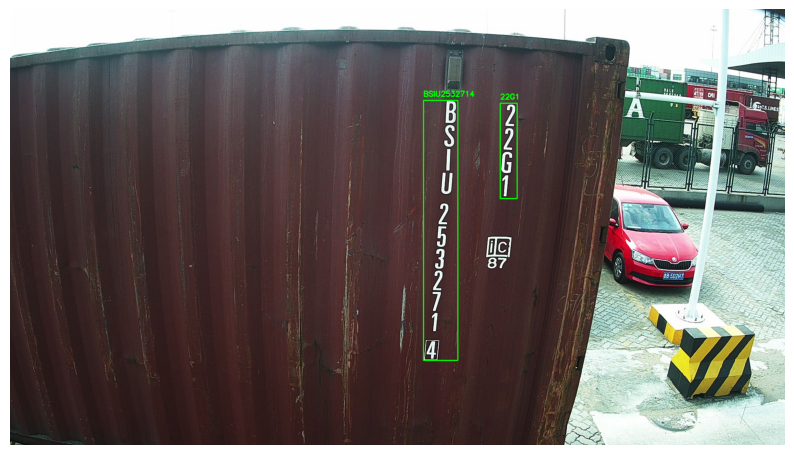

In [2]:
import cv2
from matplotlib import pyplot as plt

def draw_boxes(image_path, label_path):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for matplotlib

    with open(label_path, 'r') as f:
        for line in f:
            x1, y1, x2, y2, label = line.strip().split(',')
            x1, y1, x2, y2 = map(int, [x1, y1, x2, y2])
            cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
            cv2.putText(img, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 
                        0.6, (0, 255, 0), 2)

    plt.figure(figsize=(10, 8))
    plt.imshow(img)
    plt.axis('off')
    plt.show()

# Example usage:
draw_boxes("images/1-123511001-OCR-LF-C01.jpg", "images_label/1-123511001-OCR-LF-C01.txt")

##### Some image has more than 2 labels but in reality it should have (ID numero , ISO code)

In [4]:
def find_label_files_by_line_count(label_dir, min_lines=1, max_lines=2):
    """
    Returns a list of label file names in label_dir that have a number of lines between min_lines and max_lines (inclusive).

    Args:
        label_dir (str): Directory containing label .txt files.
        min_lines (int): Minimum number of lines (inclusive).
        max_lines (int): Maximum number of lines (inclusive).

    Returns:
        List[str]: List of file names matching the criteria.
    """
    matching_files = []
    for filename in os.listdir(label_dir):
        if filename.endswith(".txt"):
            filepath = os.path.join(label_dir, filename)
            try:
                with open(filepath, 'r') as f:
                    line_count = sum(1 for line in f)
                    if min_lines <= line_count <= max_lines:
                        matching_files.append(filename)
            except Exception as e:
                print(f"Could not read file {filepath}: {e}")
    return matching_files

##### Image with more than 3 are making problem

In [ ]:
files_with_more_than_3 = find_label_files_by_line_count("images_label", min_lines=4, max_lines=100)
print(files_with_more_than_3)

['1-123222001-OCR-LB-C02.txt', '1-124902001-OCR-RF-D01.txt', '1-133046001-OCR-AH-A01.txt', '1-140546001-OCR-LB-C02.txt', '1-144054001-OCR-LB-C02.txt']


They are minorate whe can just remove them

In [10]:
label_dir = "images_label"
files_with_more_than_3_lines = []

for filename in os.listdir(label_dir):
  if filename.endswith(".txt"):
    filepath = os.path.join(label_dir, filename)
    try:
      with open(filepath, 'r') as f:
        lines = f.readlines()
        if len(lines) > 3:
          print(f"\nContent of {filename}:")
          for line in lines:
            print(line.strip())
    except Exception as e:
      print(f"Could not read file {filepath}: {e}")


Content of 1-144054001-OCR-LB-C02.txt:
21,277,52,335,L
74,266,100,327,5
143,259,177,322,G
203,255,228,322,1
324,24,380,127,4
413,24,466,120,6
497,16,533,118,1
572,6,638,111,2
656,5,722,107,7
753,1,817,108,0
840,1,906,104,2

Content of 1-140546001-OCR-LB-C02.txt:
1,74,38,160,M
51,62,93,151,C
139,50,178,138,U
205,34,248,269,94
299,21,348,259,15
375,163,429,260,G
488,3,535,254,21
582,1,632,89,5
698,1,752,88,4
805,1,854,83,0

Content of 1-124902001-OCR-RF-D01.txt:
680,94,727,394,M624
743,94,788,394,O7505
801,87,852,395,T24G
856,331,891,395,1

Content of 1-123222001-OCR-LB-C02.txt:
356,1,509,331,MNBU420215R4
504,116,541,196,9
541,113,574,198,9
616,106,654,189,8

Content of 1-133046001-OCR-AH-A01.txt:
1684,314,1730,380,W
1673,380,1715,442,K
1658,442,1698,503,C
1647,501,1685,566,U
1630,582,1665,637,2
1614,637,1654,688,9
1604,690,1638,741,0
1597,742,1621,791,1
1579,791,1612,839,0
1565,839,1599,886,2
1537,923,1576,980,9


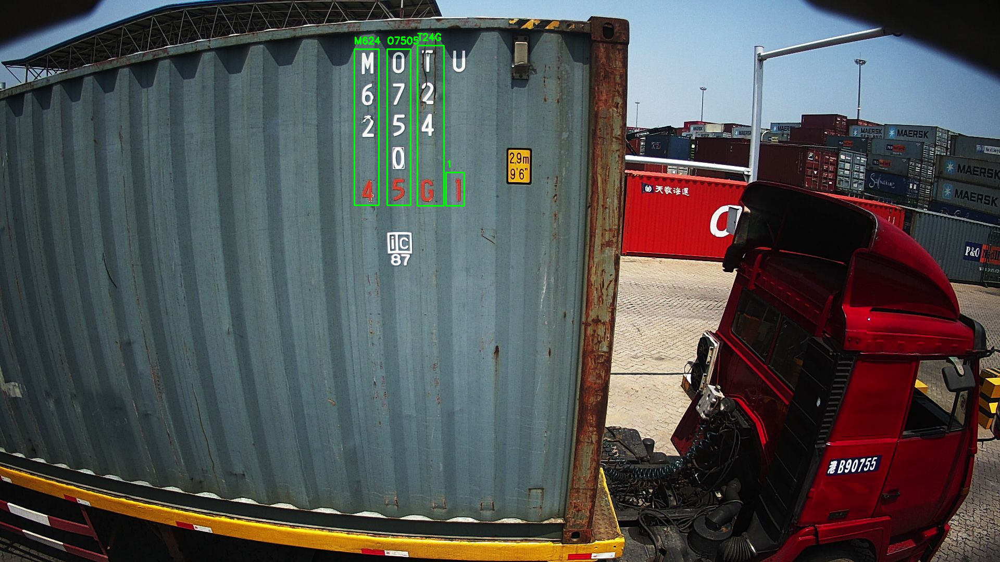

In [11]:
draw_boxes("images/1-124902001-OCR-RF-D01.jpg", "images_label/1-124902001-OCR-RF-D01.txt")

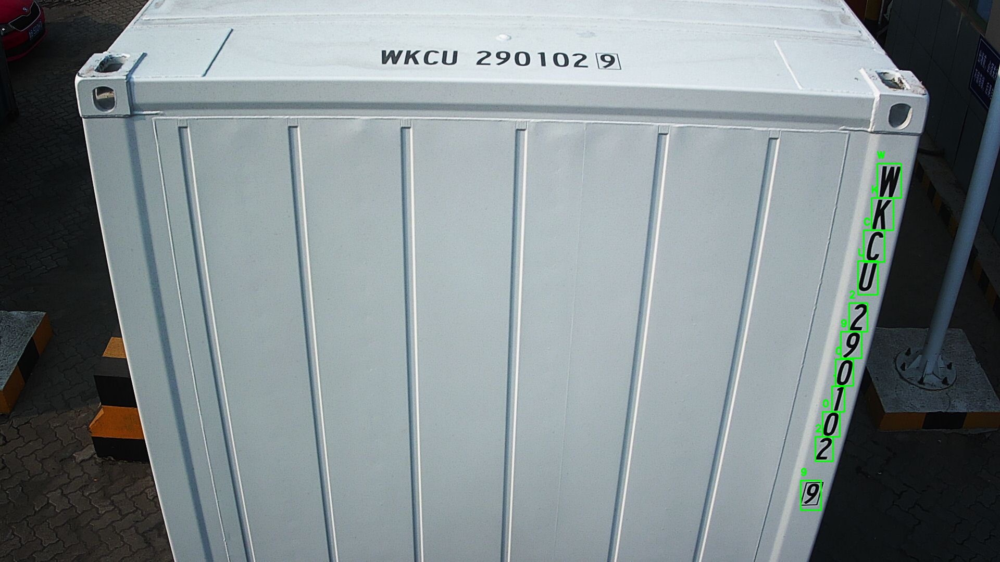

In [15]:
draw_boxes("images/1-133046001-OCR-AH-A01.jpg", "images_label/1-133046001-OCR-AH-A01.txt")

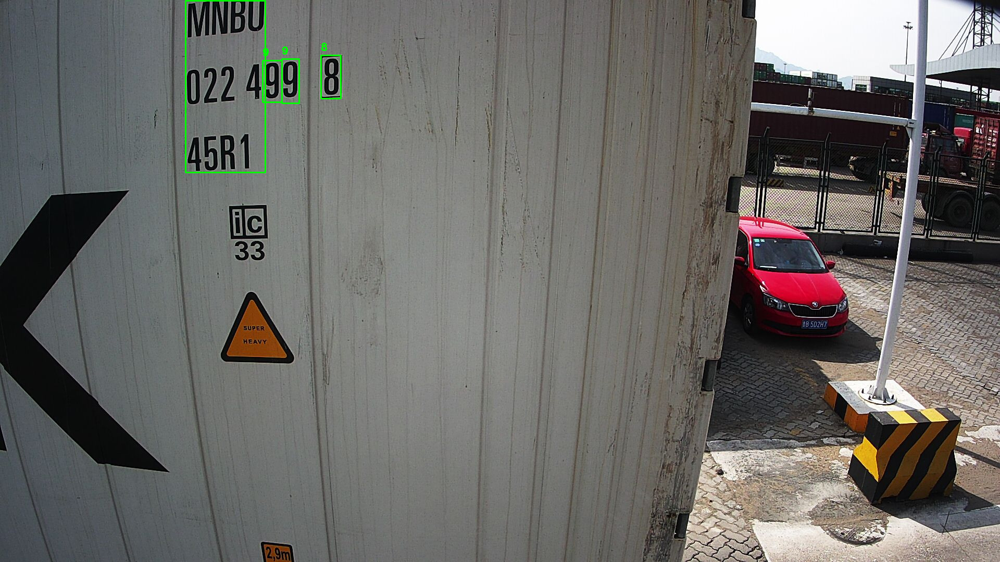

In [16]:
draw_boxes("images/1-123222001-OCR-LB-C02.jpg", "images_label/1-123222001-OCR-LB-C02.txt")

##### For image with 3 labels is not much a problem because they just separate the ID numero into the id of the owner with the 4 letters and the ID of the container the remaining

In [35]:
files_with_3_lines = find_label_files_by_line_count("images_label", min_lines=3, max_lines=3)
print(files_with_3_lines)

['1-122740001-OCR-LB-C02.txt', '1-122740001-OCR-RF-D01.txt', '1-123222001-OCR-RF-D01.txt', '1-123359001-OCR-RF-D01.txt', '1-123423001-OCR-LF-C01.txt', '1-123423001-OCR-RF-D01.txt', '1-123630001-OCR-LF-C01.txt', '1-123808001-OCR-LF-C01.txt', '1-123808001-OCR-RF-D01.txt', '1-123809001-OCR-LF-C01.txt', '1-123809001-OCR-RF-D01.txt', '1-123810001-OCR-LB-C02.txt', '1-123810001-OCR-RF-D01.txt', '1-123822001-OCR-LF-C01.txt', '1-123822001-OCR-RF-D01.txt', '1-123839001-OCR-LF-C01.txt', '1-123921001-OCR-LB-C02.txt', '1-123921001-OCR-RF-D01.txt', '1-123951001-OCR-RF-D01.txt', '1-123957001-OCR-LB-C02.txt', '1-124047001-OCR-LB-C02.txt', '1-124105001-OCR-LF-C01.txt', '1-124105001-OCR-RF-D01.txt', '1-124253001-OCR-RF-D01.txt', '1-124428001-OCR-LB-C02.txt', '1-124428001-OCR-RF-D01.txt', '1-124444001-OCR-LB-C02.txt', '1-124444001-OCR-RF-D01.txt', '1-124501001-OCR-LB-C02.txt', '1-124501001-OCR-RF-D01.txt', '1-124544001-OCR-LB-C02.txt', '1-124544001-OCR-RF-D01.txt', '1-124555001-OCR-AS-B01.txt', '1-124555

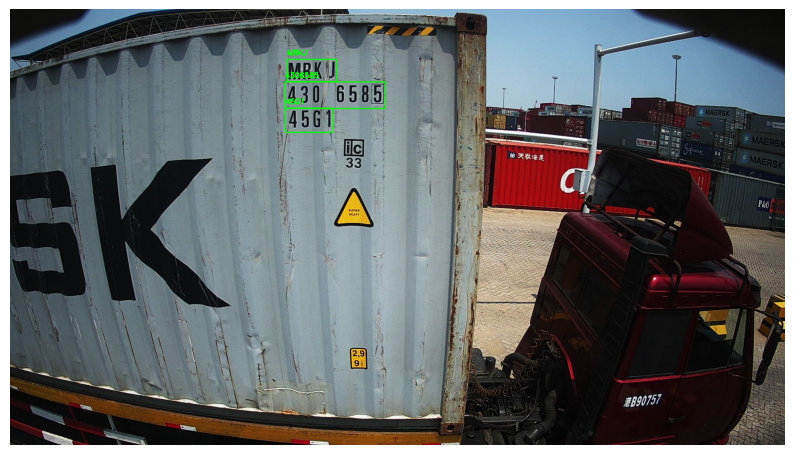

In [36]:
draw_boxes("images/1-122740001-OCR-RF-D01.jpg", "images_label/1-122740001-OCR-RF-D01.txt")

##### For the images with one label, they are also normal because they are in general captured in the Above Horizental angle where we don't have in general the ISO code

In [5]:
files_with_one_line = find_label_files_by_line_count("images_label", min_lines=1, max_lines=1)
print(files_with_one_line)

['1-122720001-OCR-AH-A01.txt', '1-122728001-OCR-AH-A01.txt', '1-122738001-OCR-AH-A01.txt', '1-122740001-OCR-AH-A01.txt', '1-122749001-OCR-AH-A01.txt', '1-122816001-OCR-AH-A01.txt', '1-122830001-OCR-AH-A01.txt', '1-122843001-OCR-AH-A01.txt', '1-122856001-OCR-AS-B01.txt', '1-122906001-OCR-AH-A01.txt', '1-122923001-OCR-AH-A01.txt', '1-122930001-OCR-AH-A01.txt', '1-123002001-OCR-AH-A01.txt', '1-123003001-OCR-AH-A01.txt', '1-123009001-OCR-AH-A01.txt', '1-123029001-OCR-AH-A01.txt', '1-123030001-OCR-AH-A01.txt', '1-123045001-OCR-AH-A01.txt', '1-123053001-OCR-AH-A01.txt', '1-123113001-OCR-AH-A01.txt', '1-123126001-OCR-AH-A01.txt', '1-123147001-OCR-AH-A01.txt', '1-123152001-OCR-AH-A01.txt', '1-123204001-OCR-AH-A01.txt', '1-123210001-OCR-AH-A01.txt', '1-123236001-OCR-AH-A01.txt', '1-123303001-OCR-AH-A01.txt', '1-123320001-OCR-AH-A01.txt', '1-123334001-OCR-AH-A01.txt', '1-123337001-OCR-AH-A01.txt', '1-123359001-OCR-AH-A01.txt', '1-123407001-OCR-AH-A01.txt', '1-123425001-OCR-AH-A01.txt', '1-123455

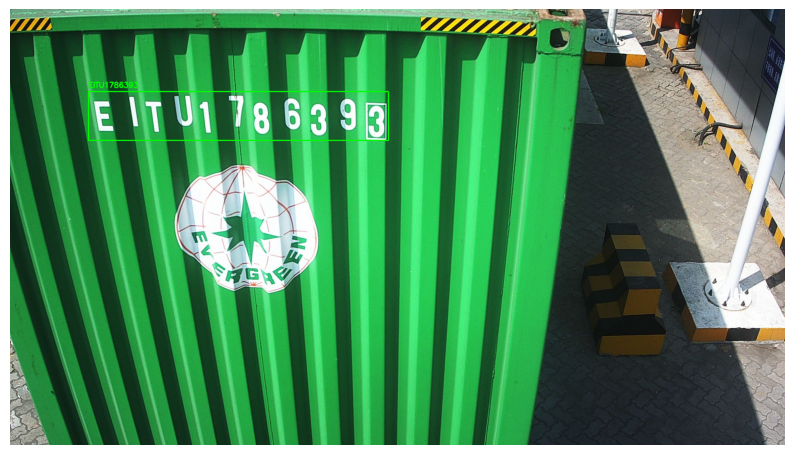

In [39]:
draw_boxes("images/1-122720001-OCR-AH-A01.jpg", "images_label/1-122720001-OCR-AH-A01.txt")

##### We will focus on the FrontRight(RF) and AboveSide(AS) angle, where there exist multiple information

Drawing boxes for 1-122856001-OCR-AS-B01.jpg with label 1-122856001-OCR-AS-B01.txt


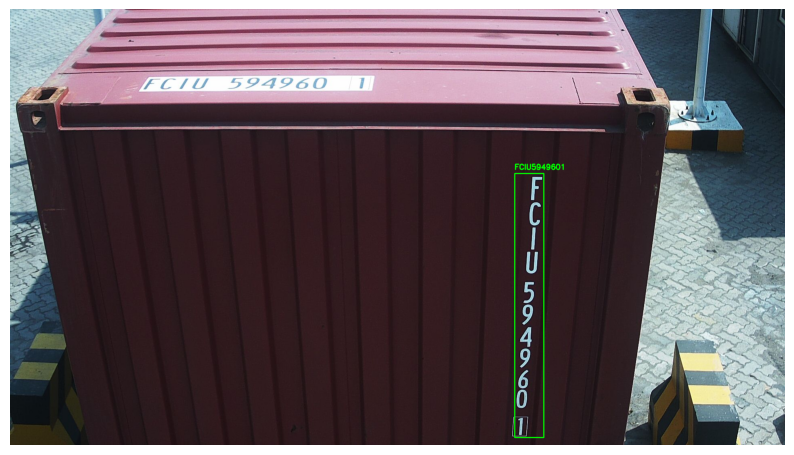

Drawing boxes for 1-131119001-OCR-AS-B01.jpg with label 1-131119001-OCR-AS-B01.txt


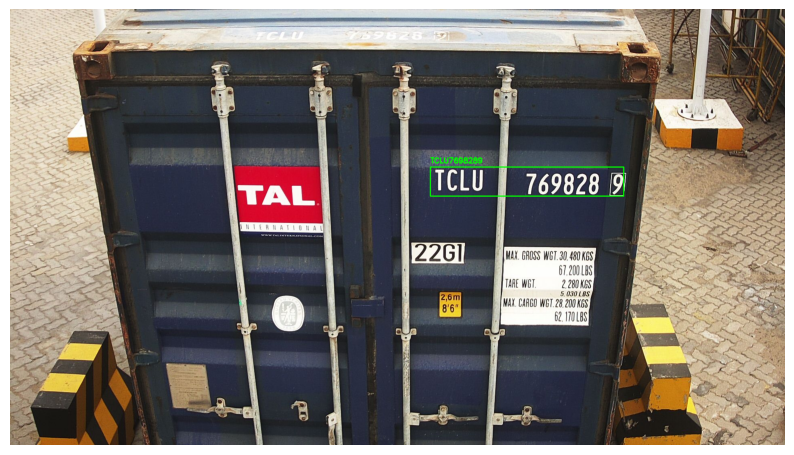

Drawing boxes for 1-131119001-OCR-RF-D01.jpg with label 1-131119001-OCR-RF-D01.txt


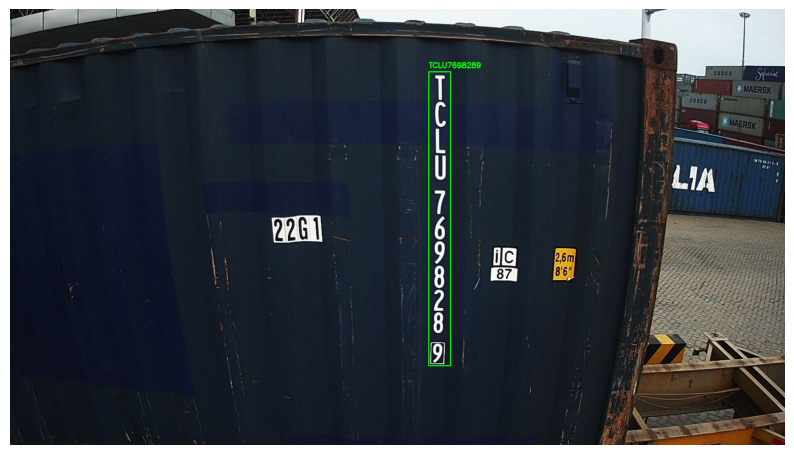

Drawing boxes for 1-134910001-OCR-AS-B01.jpg with label 1-134910001-OCR-AS-B01.txt


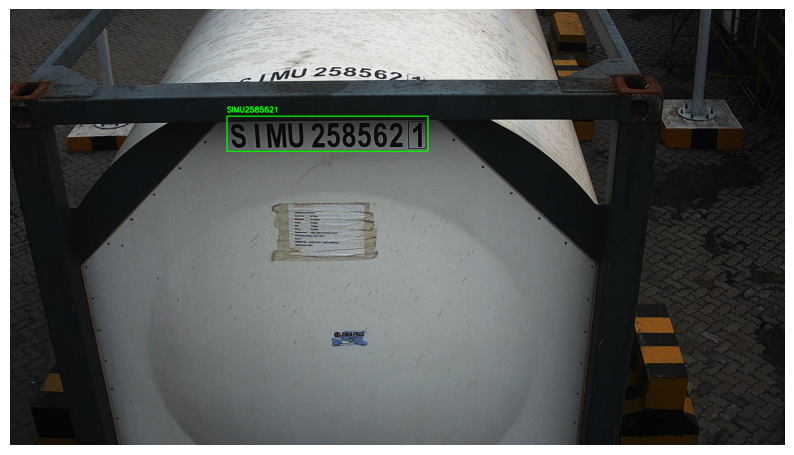

Drawing boxes for 1-140504001-OCR-AS-B01.jpg with label 1-140504001-OCR-AS-B01.txt


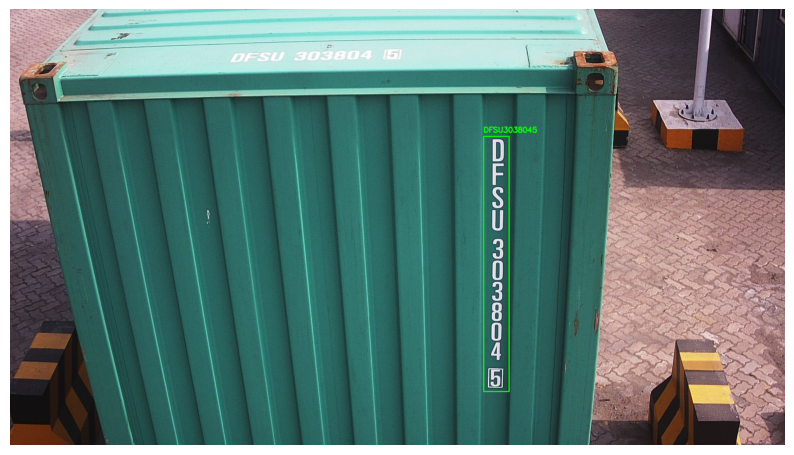

Drawing boxes for 1-141718001-OCR-AS-B01.jpg with label 1-141718001-OCR-AS-B01.txt


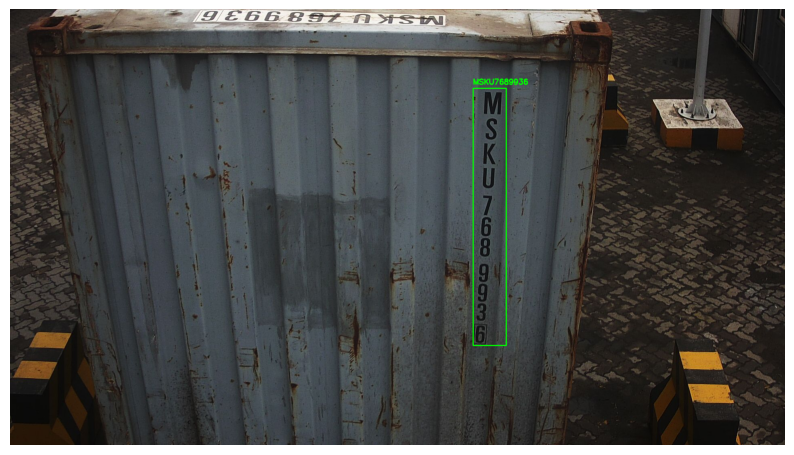

Drawing boxes for 1-154749001-OCR-AS-B01.jpg with label 1-154749001-OCR-AS-B01.txt


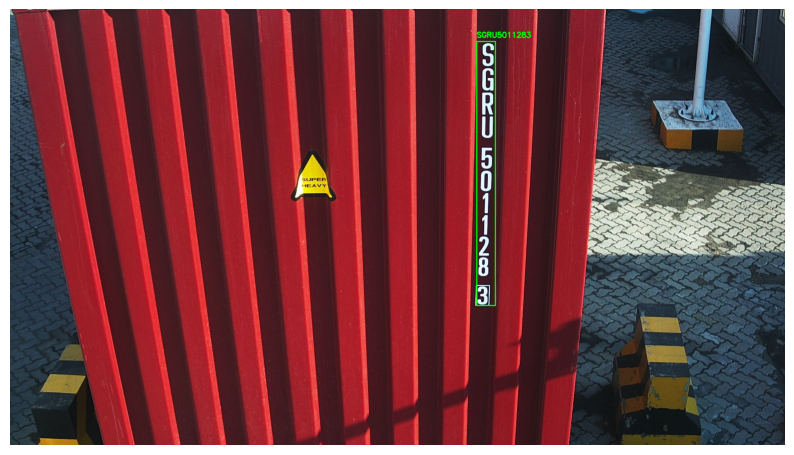

Drawing boxes for 1-155214001-OCR-AS-B01.jpg with label 1-155214001-OCR-AS-B01.txt


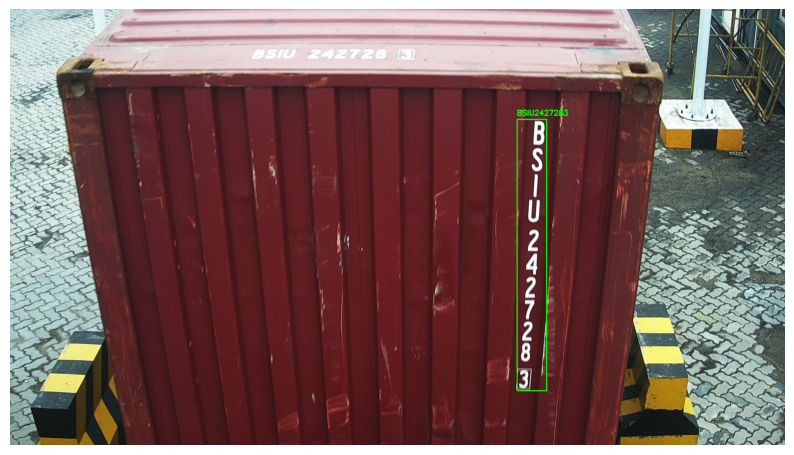

In [6]:
for filename in files_with_one_line:
    if 'RF' in filename or 'AS' in filename:
        image_name = filename.replace("txt", "jpg")
        image_path = os.path.join("images", image_name)
        label_path = os.path.join("images_label", filename)
        print(f"Drawing boxes for {image_name} with label {filename}")
        draw_boxes(image_path, label_path)

# Data Preprocessing

### Resizing the image (contour)

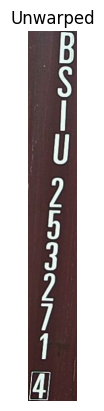

array([[[ 83,  68,  71],
        [ 79,  67,  69],
        [ 78,  63,  66],
        ...,
        [ 67,  61,  65],
        [ 68,  59,  64],
        [ 71,  60,  66]],

       [[ 83,  68,  71],
        [ 79,  67,  69],
        [ 78,  63,  66],
        ...,
        [ 69,  63,  67],
        [ 69,  60,  65],
        [ 71,  60,  66]],

       [[ 82,  67,  70],
        [ 79,  67,  69],
        [ 79,  64,  67],
        ...,
        [ 71,  65,  69],
        [ 70,  61,  66],
        [ 72,  61,  67]],

       ...,

       [[ 37,  31,  31],
        [ 20,  22,  21],
        [232, 234, 233],
        ...,
        [ 64,  36,  35],
        [ 68,  36,  37],
        [ 70,  38,  39]],

       [[ 28,  16,  18],
        [ 14,   8,  10],
        [171, 167, 168],
        ...,
        [ 62,  34,  33],
        [ 67,  35,  36],
        [ 70,  38,  39]],

       [[ 39,  16,  22],
        [ 58,  37,  44],
        [ 21,   0,   7],
        ...,
        [ 61,  33,  32],
        [ 67,  35,  36],
        [ 71,  39,  40]]

In [14]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

def crop_and_unwarp(image_path, label_path, unwarp=False):
    img = cv2.imread(image_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    boxes = []
    with open(label_path, 'r') as f:
        for line in f:
            x1, y1, x2, y2, label = line.strip().split(',')
            x1, y1, x2, y2 = map(int, [x1, y1, x2, y2])
            boxes.append((x1, y1, x2, y2, label))
    
    # For simplicity, crop the first box (usually the container ID)
    if not boxes:
        print("No boxes found.")
        return
    x1, y1, x2, y2, label = boxes[0]
    cropped = img_rgb[y1:y2, x1:x2]

    if unwarp:
        # Example: Assume the box is a rectangle, but you can use detected corners for more accuracy
        src_pts = np.float32([
            [x1, y1],
            [x2, y1],
            [x2, y2],
            [x1, y2]
        ])
        width = x2 - x1
        height = y2 - y1
        dst_pts = np.float32([
            [0, 0],
            [width-1, 0],
            [width-1, height-1],
            [0, height-1]
        ])
        M = cv2.getPerspectiveTransform(src_pts, dst_pts)
        unwarped = cv2.warpPerspective(img_rgb, M, (width, height))
        plt.imshow(unwarped)
        plt.title("Unwarped")
        plt.axis('off')
        plt.show()
        return unwarped
    else:
        plt.imshow(cropped)
        plt.title("Cropped")
        plt.axis('off')
        plt.show()
        return cropped

# Example usage:
crop_and_unwarp("images/1-123511001-OCR-LF-C01.jpg", "images_label/1-123511001-OCR-LF-C01.txt", unwarp=True)

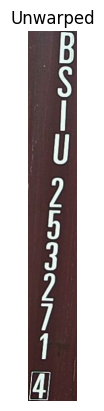

array([[[ 83,  68,  71],
        [ 79,  67,  69],
        [ 78,  63,  66],
        ...,
        [ 67,  61,  65],
        [ 68,  59,  64],
        [ 71,  60,  66]],

       [[ 83,  68,  71],
        [ 79,  67,  69],
        [ 78,  63,  66],
        ...,
        [ 69,  63,  67],
        [ 69,  60,  65],
        [ 71,  60,  66]],

       [[ 82,  67,  70],
        [ 79,  67,  69],
        [ 79,  64,  67],
        ...,
        [ 71,  65,  69],
        [ 70,  61,  66],
        [ 72,  61,  67]],

       ...,

       [[ 37,  31,  31],
        [ 20,  22,  21],
        [232, 234, 233],
        ...,
        [ 64,  36,  35],
        [ 68,  36,  37],
        [ 70,  38,  39]],

       [[ 28,  16,  18],
        [ 14,   8,  10],
        [171, 167, 168],
        ...,
        [ 62,  34,  33],
        [ 67,  35,  36],
        [ 70,  38,  39]],

       [[ 39,  16,  22],
        [ 58,  37,  44],
        [ 21,   0,   7],
        ...,
        [ 61,  33,  32],
        [ 67,  35,  36],
        [ 71,  39,  40]]

In [19]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

def crop_and_unwarp(image_path, label_path, unwarp=False):
    img = cv2.imread(image_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    boxes = []
    with open(label_path, 'r') as f:
        for line in f:
            x1, y1, x2, y2, label = line.strip().split(',')
            x1, y1, x2, y2 = map(int, [x1, y1, x2, y2])
            boxes.append((x1, y1, x2, y2, label))
    
    # For simplicity, crop the first box (usually the container ID)
    if not boxes:
        print("No boxes found.")
        return
    x1, y1, x2, y2, label = boxes[0]
    cropped = img_rgb[y1:y2, x1:x2]

    if unwarp:
        # Example: Assume the box is a rectangle, but you can use detected corners for more accuracy
        src_pts = np.float32([
            [x1, y1],
            [x2, y1],
            [x2, y2],
            [x1, y2]
        ])
        width = x2 - x1
        height = y2 - y1
        dst_pts = np.float32([
            [0, 0],
            [width-1, 0],
            [width-1, height-1],
            [0, height-1]
        ])
        M = cv2.getPerspectiveTransform(src_pts, dst_pts)
        unwarped = cv2.warpPerspective(img_rgb, M, (width, height))
        plt.imshow(unwarped)
        plt.title("Unwarped")
        plt.axis('off')
        plt.show()
        return unwarped
    else:
        plt.imshow(cropped)
        plt.title("Cropped")
        plt.axis('off')
        plt.show()
        return cropped

# Example usage:
crop_and_unwarp("images/1-123511001-OCR-LF-C01.jpg", "images_label/1-123511001-OCR-LF-C01.txt", unwarp=True)